# Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import matplotlib.pyplot as plt

In [3]:
import warnings
# warnings.filterwarnings(action='once')
warnings.filterwarnings('ignore')

In [4]:
import os
from collections import OrderedDict

import scanpy as sc
import pandas as pd
import numpy as np
from pathlib import Path

import matplotlib.pyplot as plt

from drvi_notebooks.utils.data.adata_plot_pp import make_balanced_subsample
from drvi_notebooks.utils.data.data_configs import get_data_info
from drvi_notebooks.utils.run_info import get_run_info_for_dataset
from drvi_notebooks.utils.latent import set_optimal_ordering

In [5]:
sc.set_figure_params(vector_friendly=True, dpi_save=300)

In [6]:
import mplscience
mplscience.available_styles()
mplscience.set_style()

['default', 'despine']


# Config

In [7]:
cwd = os.getcwd()
cwd

'/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public/drvi_notebooks/analysis'

In [8]:
proj_dir = Path(cwd).parent.parent
proj_dir

PosixPath('/ictstr01/home/icb/amirali.moinfar/projects/drvi_reproducibility_public')

In [9]:
(proj_dir / 'plots' / 'dim_effect').mkdir(parents=True, exist_ok=True)

In [10]:
logs_dir = Path(os.path.expanduser('~/workspace/train_logs'))
logs_dir

PosixPath('/home/icb/amirali.moinfar/workspace/train_logs')

In [11]:
cat_10_pallete = sc.plotting.palettes.vega_10_scanpy
cat_10_pallete_without_grey = [c for c in cat_10_pallete if c != '#7f7f7f']
cat_20_pallete = sc.plotting.palettes.vega_20_scanpy
wong_pallete = [
    "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7", "#000000",
]
cat_100_pallete = sc.plotting.palettes.godsnot_102

## Data

## Runs to load

In [12]:
datasets = OrderedDict([
    ('pancreas_scvelo', dict(
        name='Developmental\npancreas',
    )),
    ('hlca', dict(
        name='Human lung\ncell atlas',
    )),
    ('norman_hvg', dict(
        # name='Norman\nPerturb-seq',
        name='CRISPR screen\n',
    )),
    ('retina_organoid_hvg', dict(
        name='Retina organoid\n',
    )),
    ('immune_hvg', dict(
        name='Immune\n',
    )),
    ('pbmc_covid_hvg', dict(
        name='PBMC\n',
    )),
    ('zebrafish_hvg', dict(
        # name='Zebrafish\n',
        name='Daniocell\n',
    )),
])
datasets

OrderedDict([('pancreas_scvelo', {'name': 'Developmental\npancreas'}),
             ('hlca', {'name': 'Human lung\ncell atlas'}),
             ('norman_hvg', {'name': 'CRISPR screen\n'}),
             ('retina_organoid_hvg', {'name': 'Retina organoid\n'}),
             ('immune_hvg', {'name': 'Immune\n'}),
             ('pbmc_covid_hvg', {'name': 'PBMC\n'}),
             ('zebrafish_hvg', {'name': 'Daniocell\n'})])

In [13]:
run_version = "4.3"

all_embeds = {}
for run_name in [
    'immune_hvg_ablation',
    'pancreas_scvelo_ablation',
    'retina_organoid_hvg_ablation',
    'norman_hvg_ablation',
    'hlca_ablation',
    'pbmc_covid_hvg_ablation',
    'zebrafish_hvg_ablation',
]:
    print(run_name)

    run_info = get_run_info_for_dataset(run_name)
    RUNS_TO_LOAD = run_info.run_dirs
    scatter_point_size = run_info.scatter_point_size
    adata_to_transfer_obs = run_info.adata_to_transfer_obs
    
    for k,v in RUNS_TO_LOAD.items():
        if not os.path.exists(v):
            raise ValueError(f"{v} does not exists.")
        
    embeds = {}
    random_order = None
    for method_name, run_path in RUNS_TO_LOAD.items():
        if int(method_name.split(" ")[0]) < 32:
            continue
        if int(method_name.split(" ")[0]) > 512:
            continue
        print(method_name)
        if str(run_path).endswith(".h5ad"):
            embed = sc.read(run_path)
        else:
            embed = sc.read(run_path / 'latent.h5ad')
        set_optimal_ordering(embed, key_added='optimal_var_order', metric='euclidean+')
        if random_order is None:
            random_order = embed.obs.sample(frac=1.).index
        embed = embed[random_order].copy()
        embeds[method_name] = embed
        if adata_to_transfer_obs is not None:
            for col in adata_to_transfer_obs.obs.columns:
                if col not in embed.obs.columns:
                    embed.obs[col] = adata_to_transfer_obs.obs[col]

    all_embeds[run_name.split("_ablation")[0]] = embeds
all_embeds.keys()

immune_hvg_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
pancreas_scvelo_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
retina_organoid_hvg_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
norman_hvg_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
hlca_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
pbmc_covid_hvg_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional
zebrafish_hvg_ablation
32 Dimensional
64 Dimensional
128 Dimensional
256 Dimensional
512 Dimensional


dict_keys(['immune_hvg', 'pancreas_scvelo', 'retina_organoid_hvg', 'norman_hvg', 'hlca', 'pbmc_covid_hvg', 'zebrafish_hvg'])

In [14]:
all_info = {
    run_name: get_data_info(run_name, run_version)
    for run_name in all_embeds.keys()
}

immune_hvg
32 Dimensional


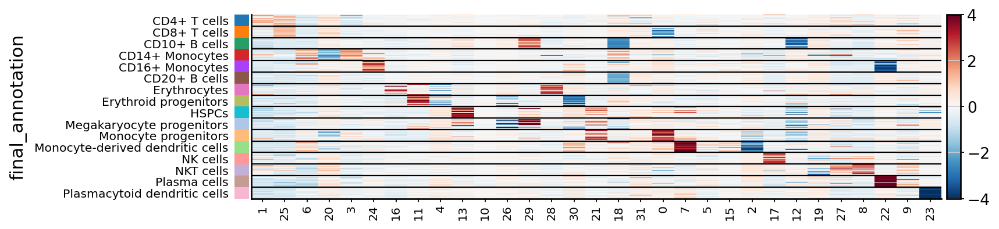

64 Dimensional


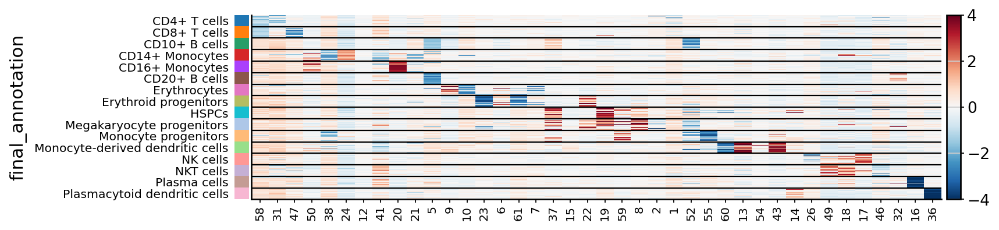

128 Dimensional


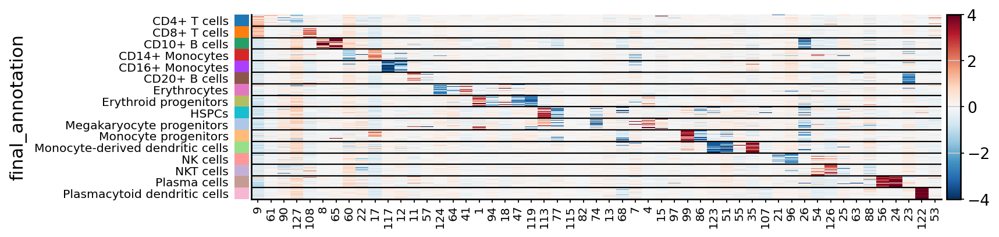

256 Dimensional


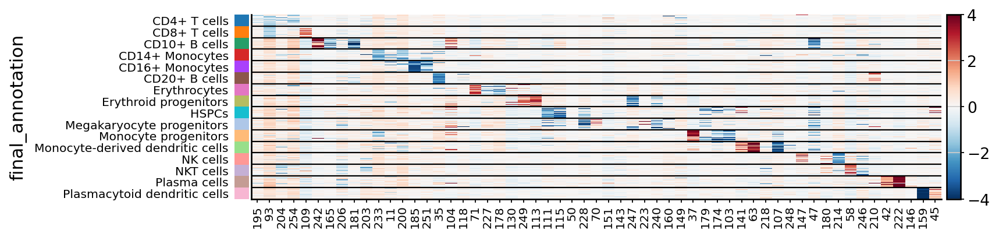

512 Dimensional


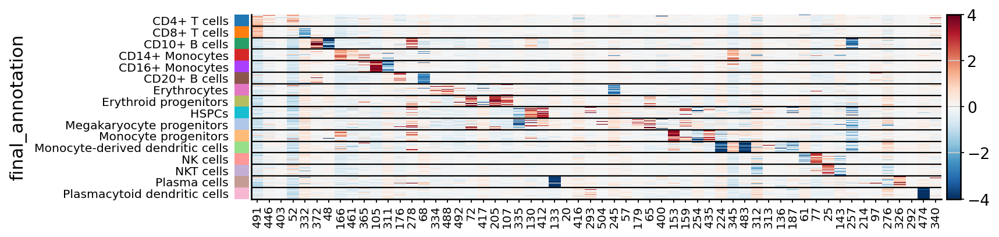

pancreas_scvelo
32 Dimensional


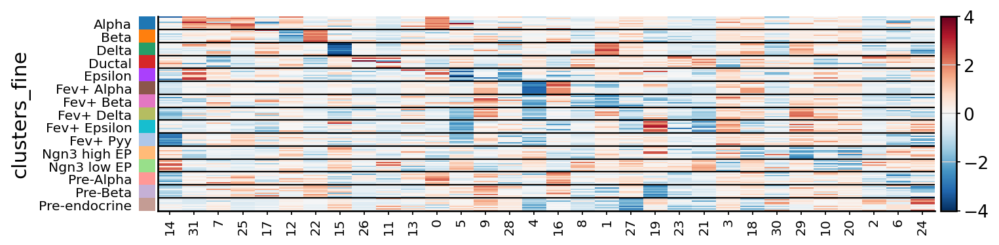

64 Dimensional


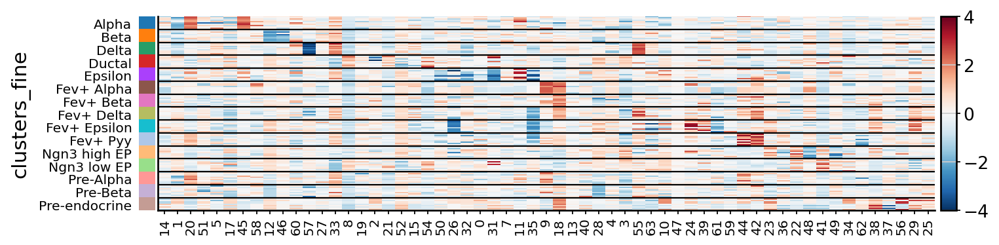

128 Dimensional


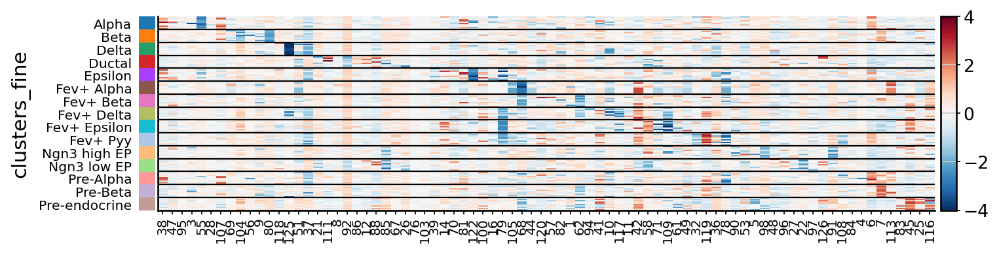

256 Dimensional


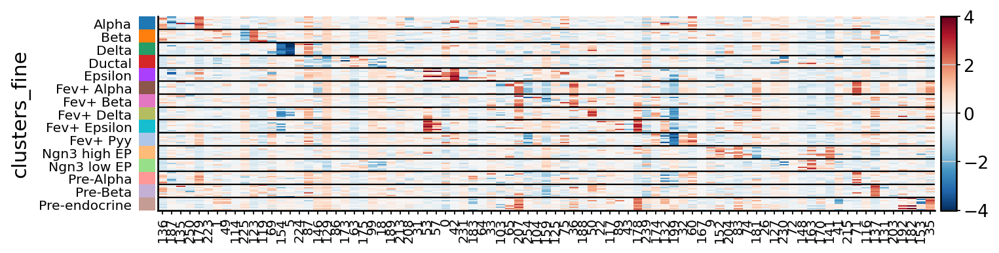

512 Dimensional


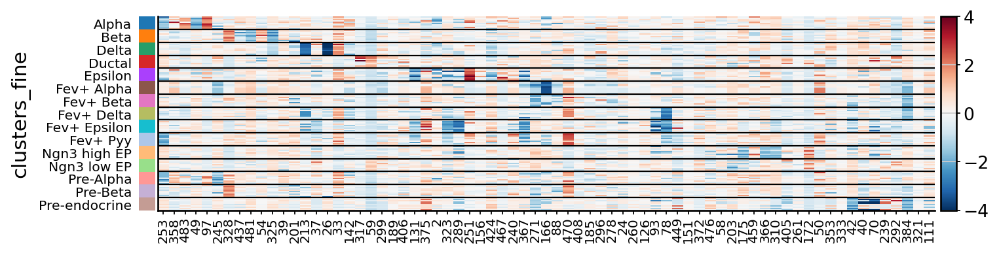

retina_organoid_hvg
32 Dimensional


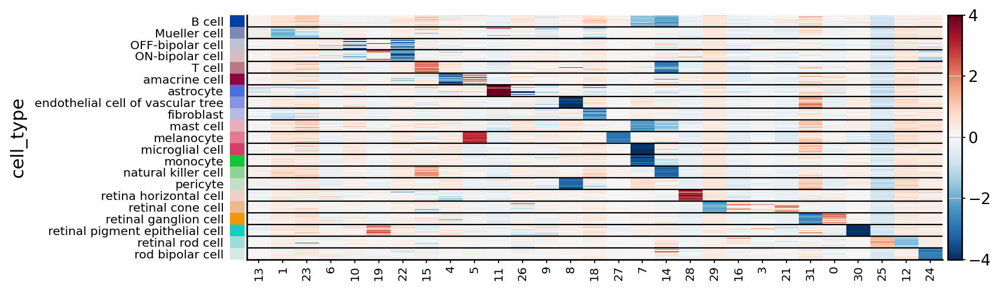

64 Dimensional


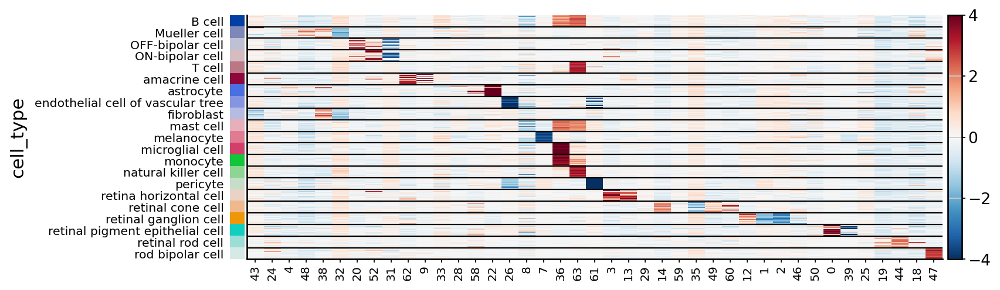

128 Dimensional


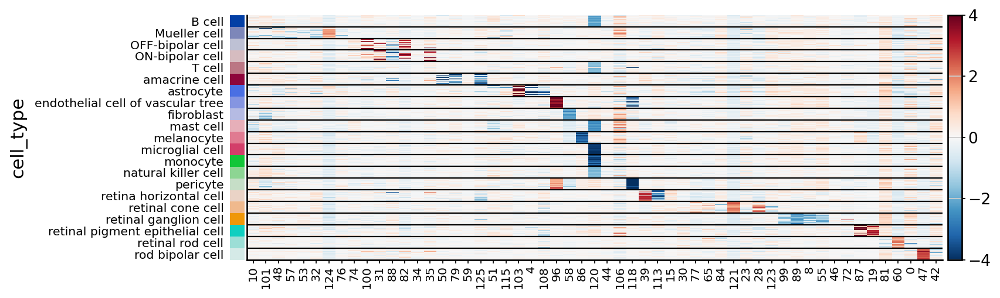

256 Dimensional


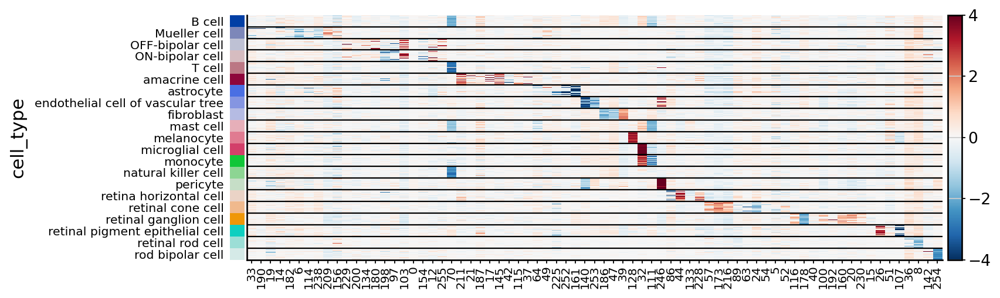

512 Dimensional


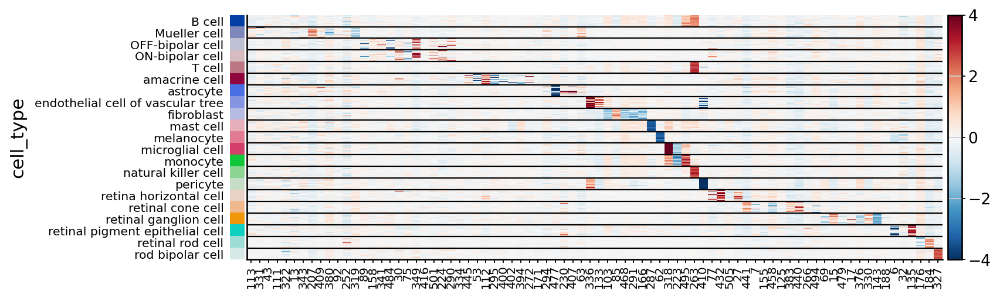

norman_hvg
32 Dimensional


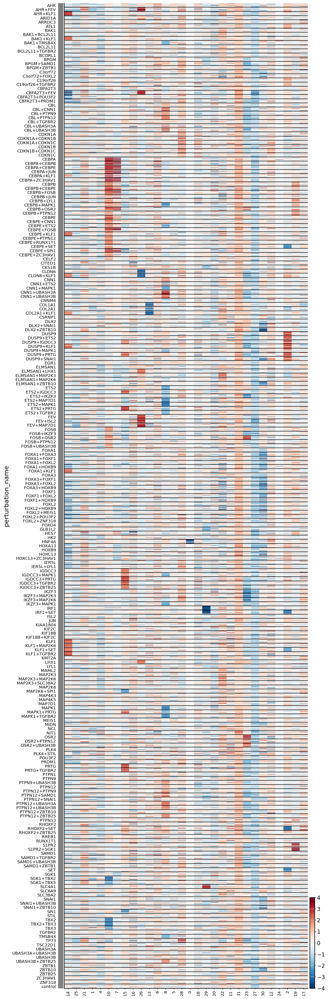

64 Dimensional


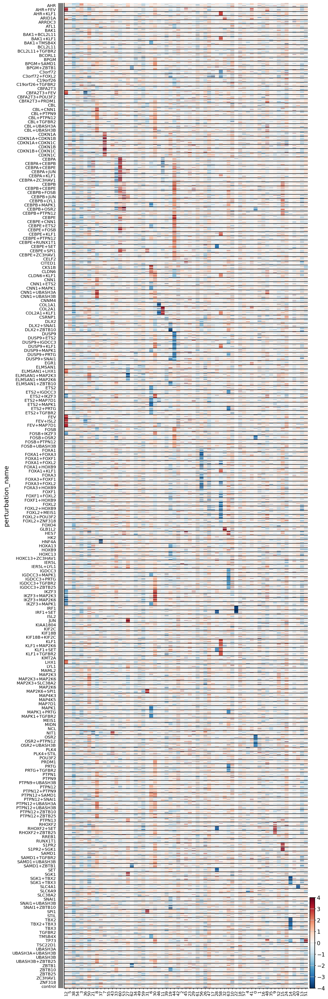

128 Dimensional


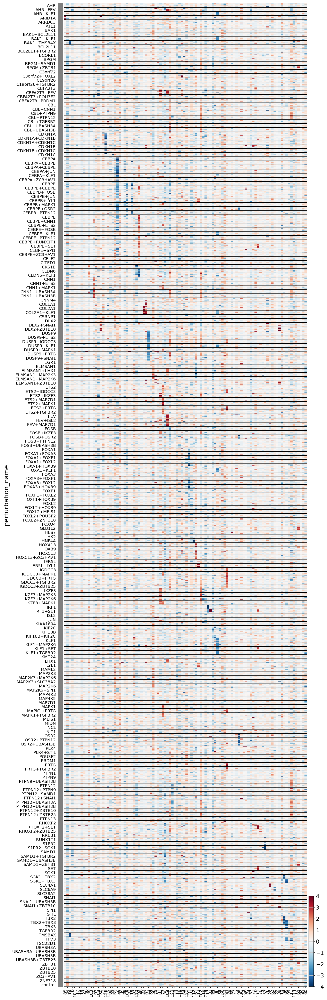

256 Dimensional


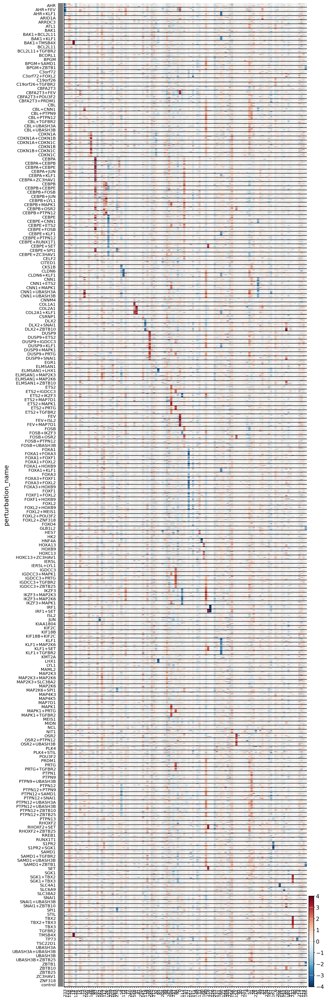

512 Dimensional


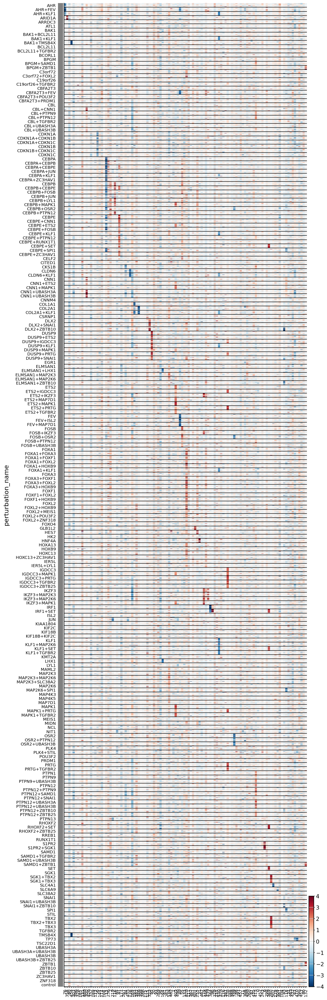

hlca
32 Dimensional


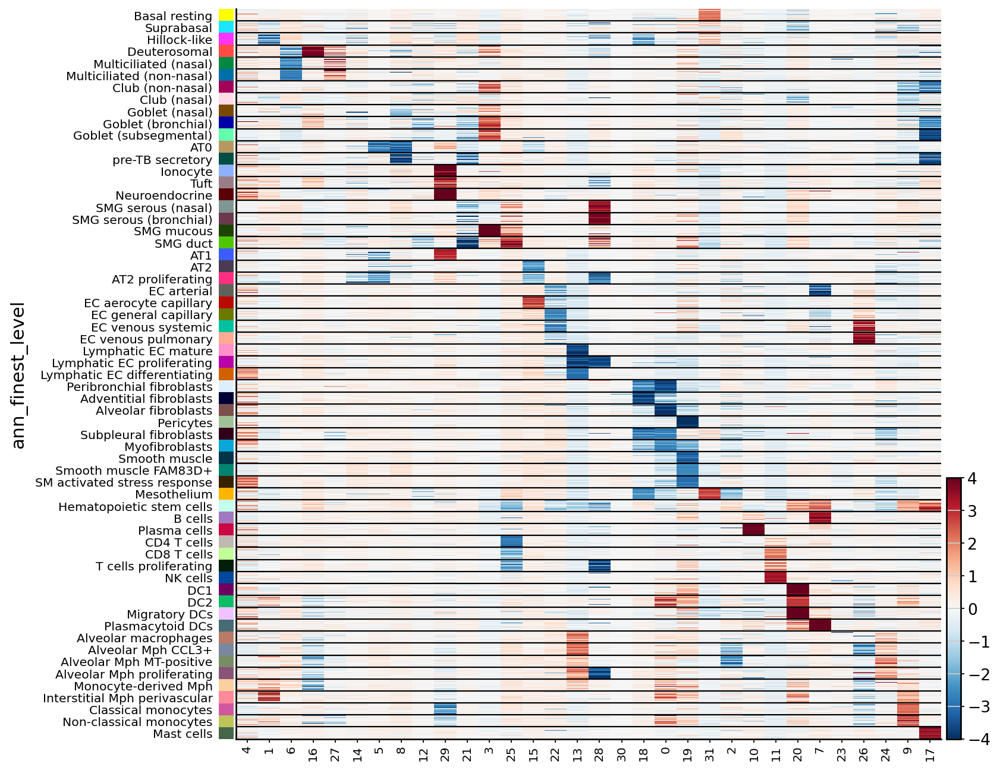

64 Dimensional


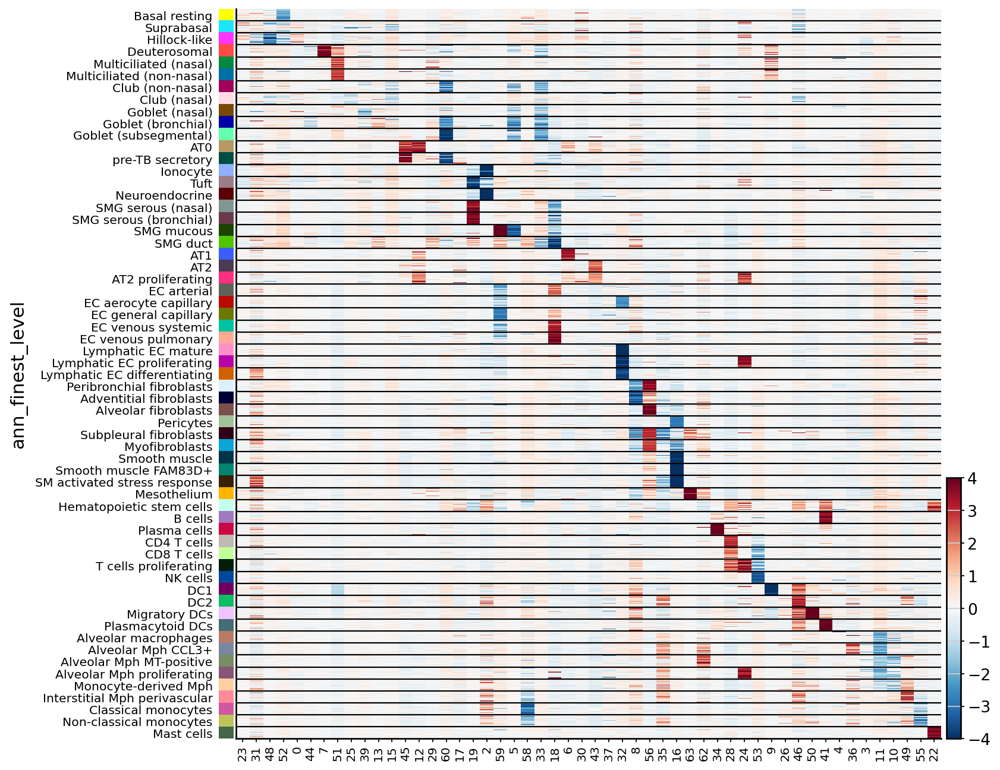

128 Dimensional


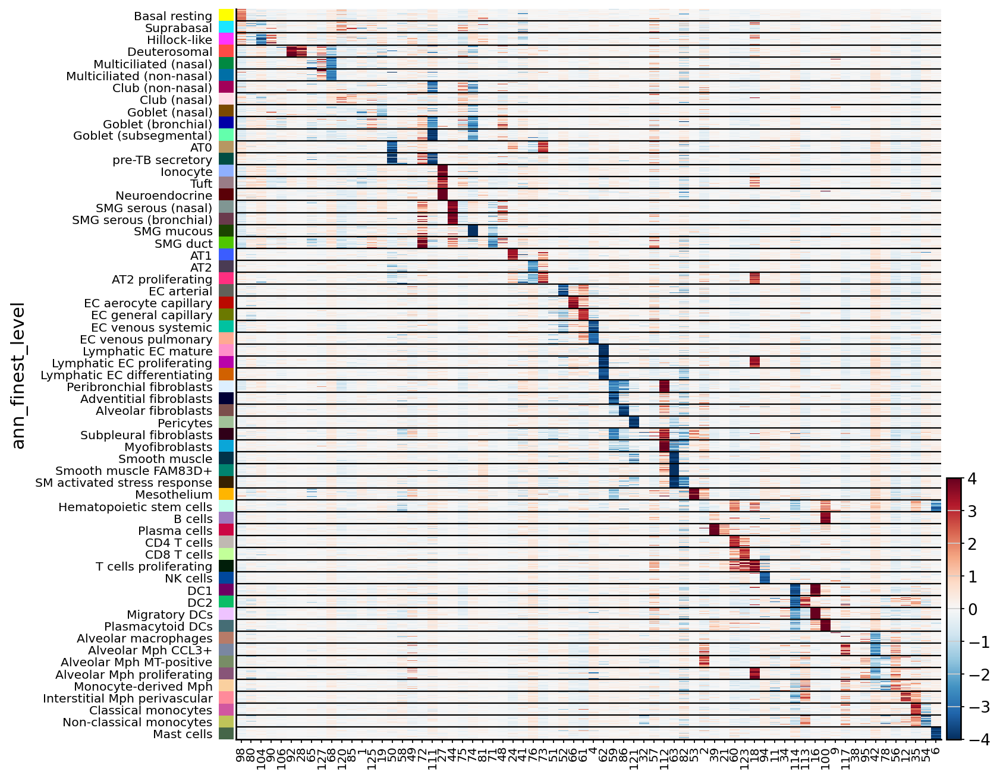

256 Dimensional


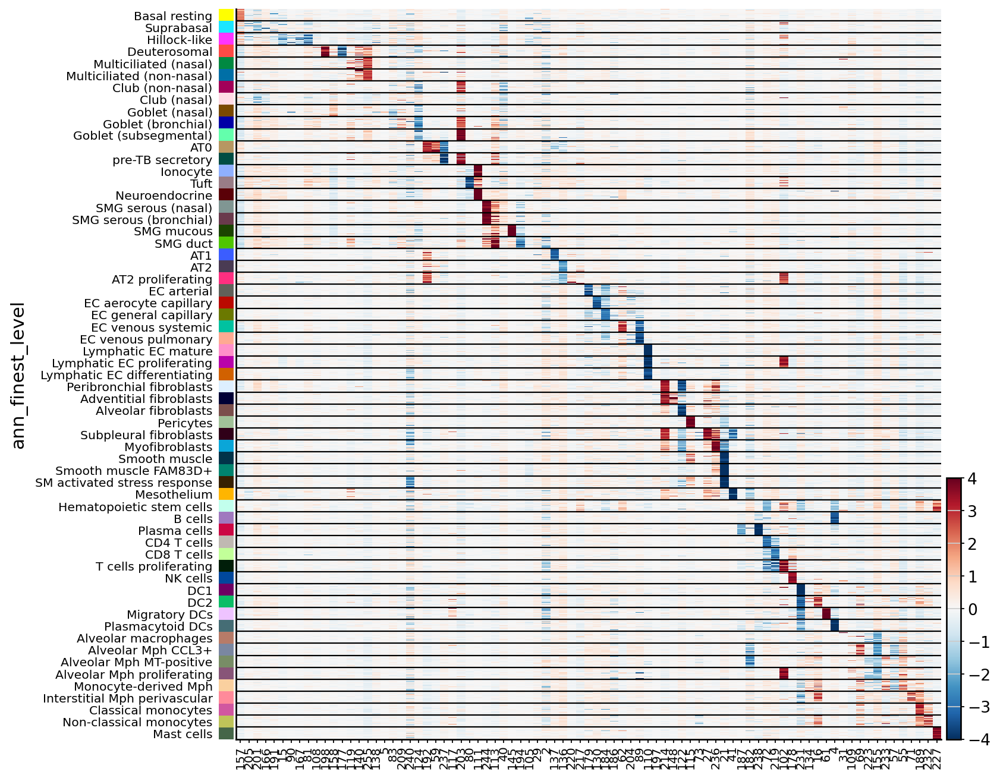

512 Dimensional


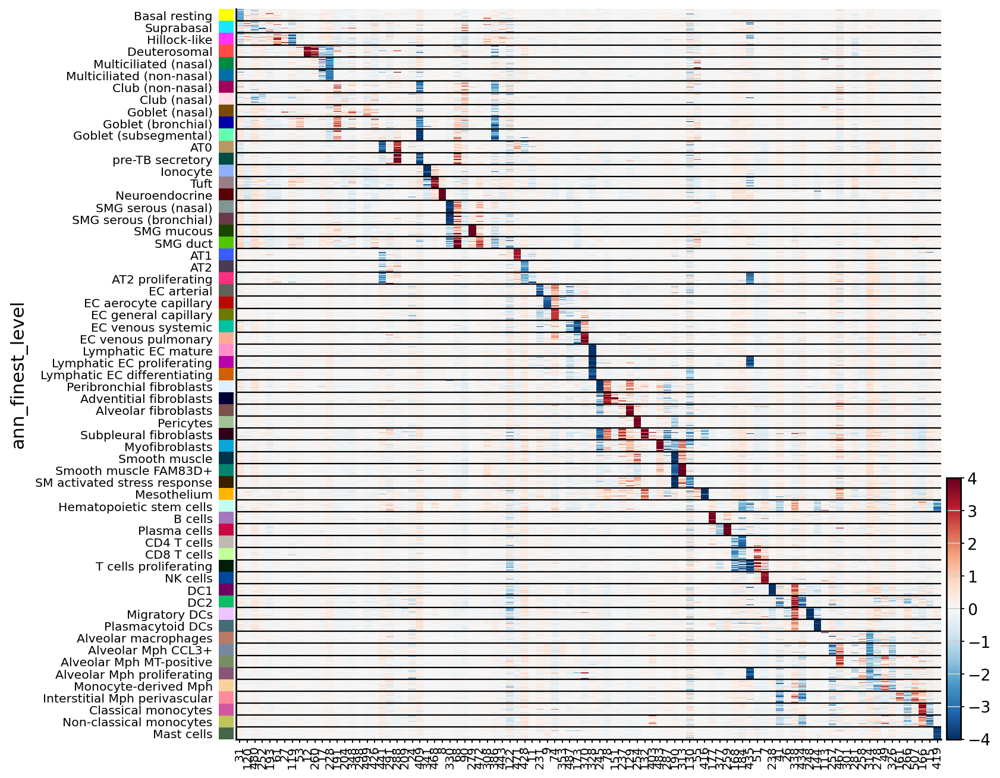

pbmc_covid_hvg
32 Dimensional


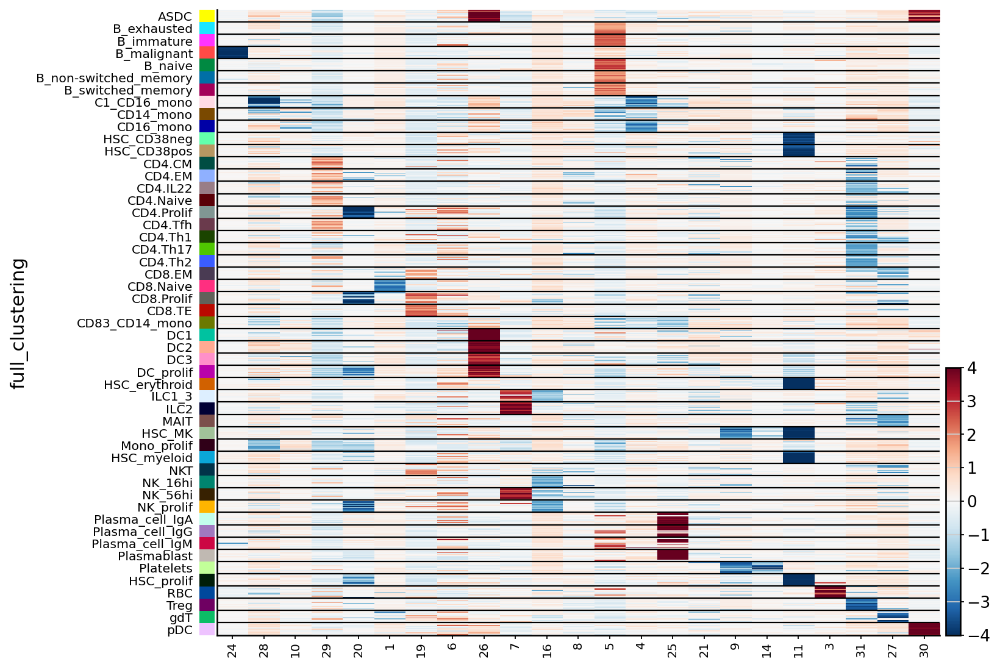

64 Dimensional


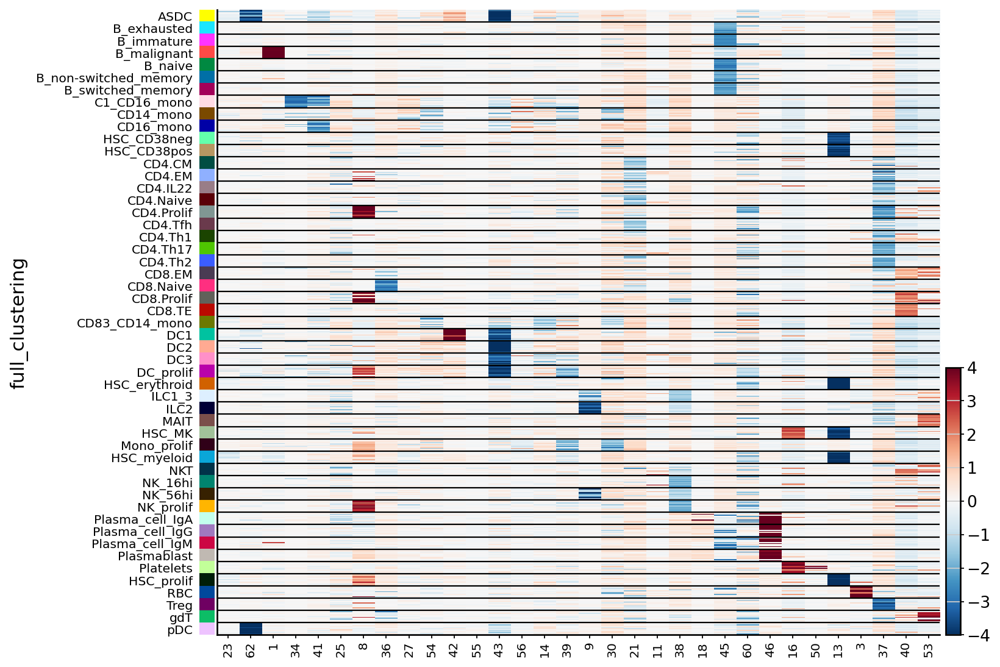

128 Dimensional


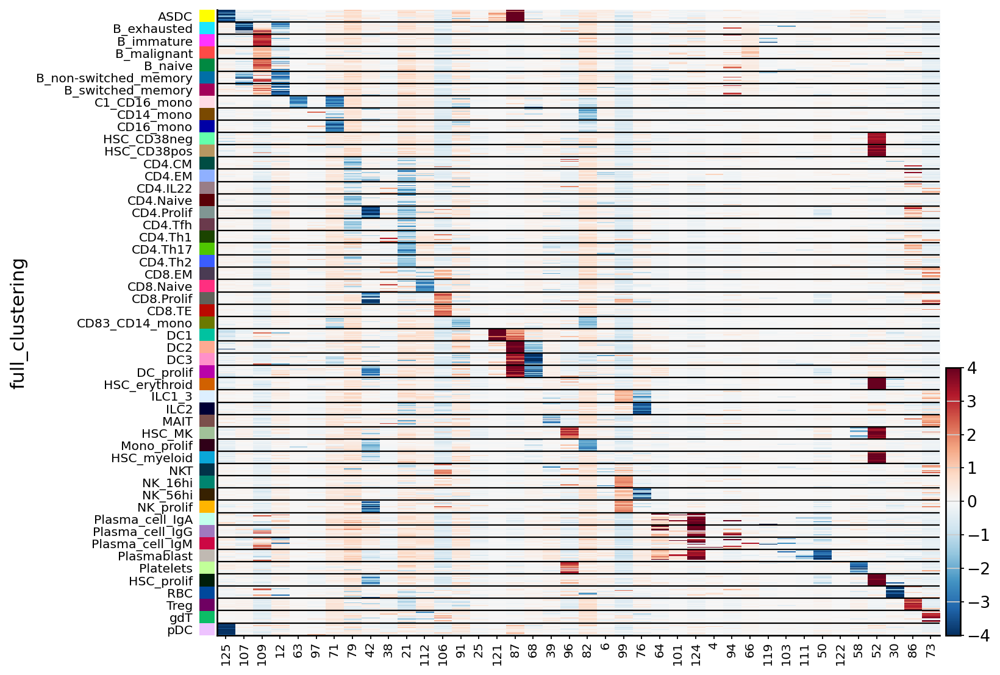

256 Dimensional


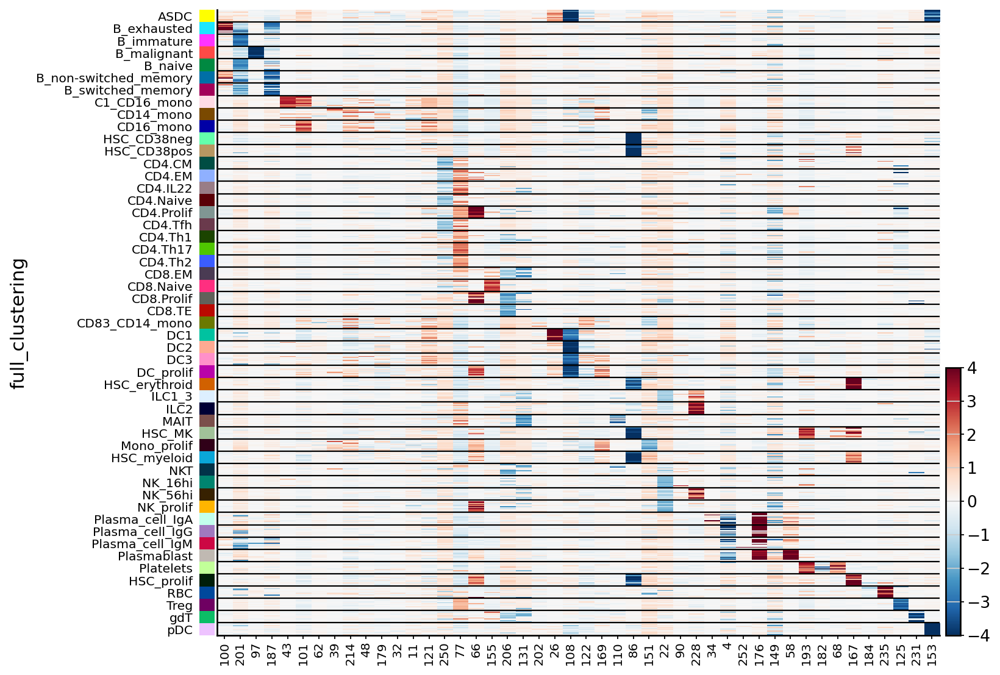

512 Dimensional


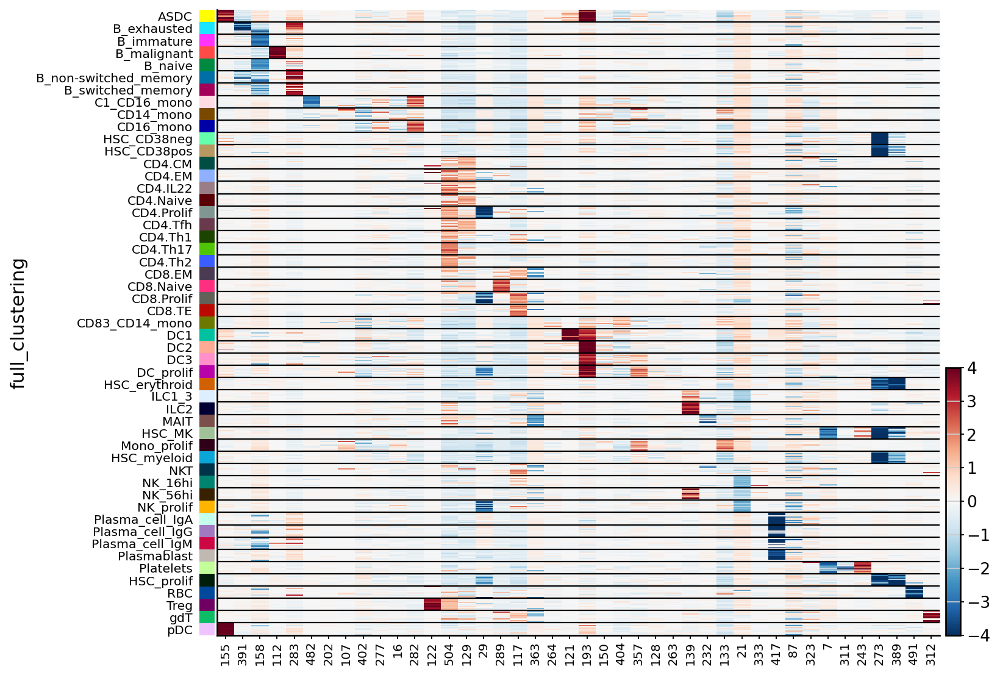

zebrafish_hvg
32 Dimensional


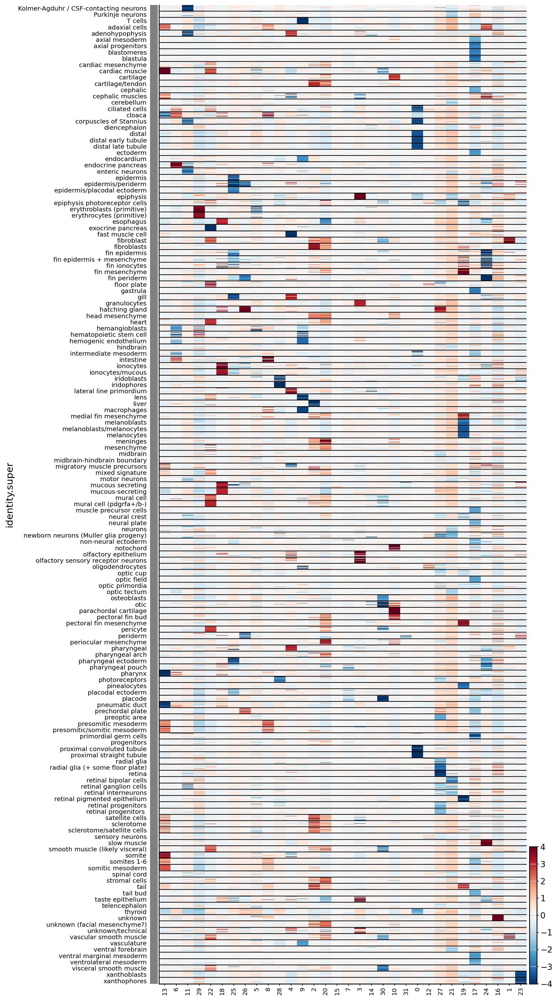

64 Dimensional


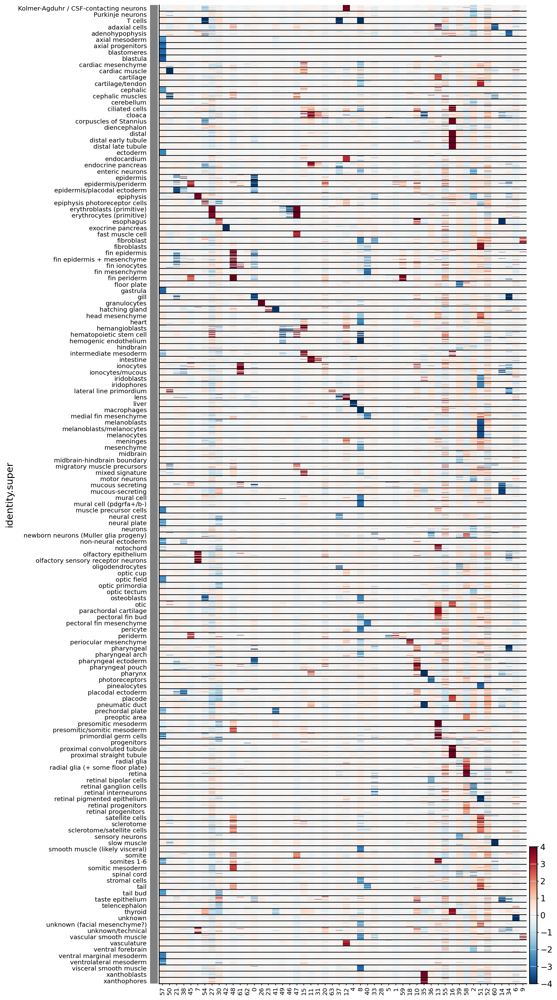

128 Dimensional


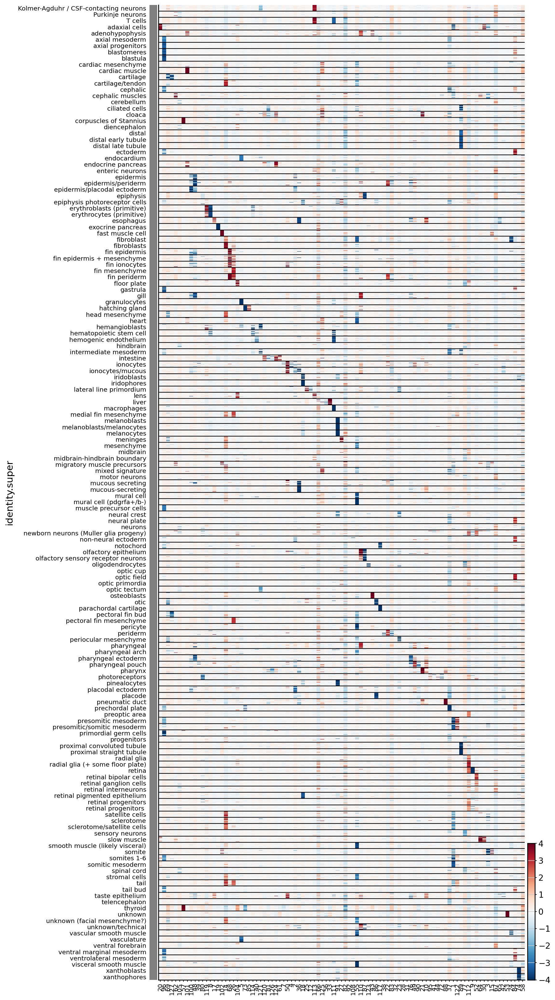

256 Dimensional


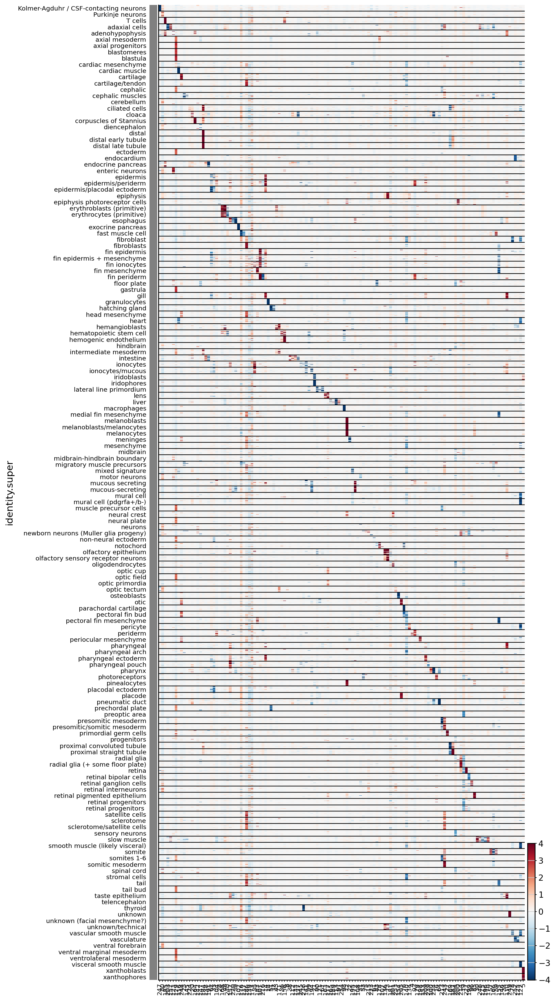

512 Dimensional


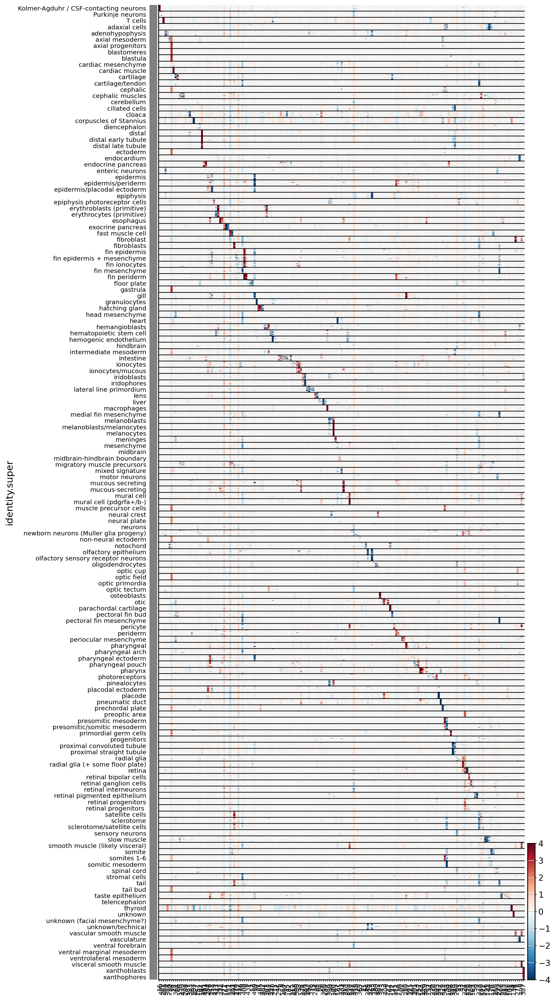

In [15]:
for run_name, embeds in all_embeds.items():
    print(run_name)
    for method_name, embed in embeds.items():
        print(method_name)
        k = all_info[run_name]['cell_type_key']
        non_vanished_vars = np.arange(embed.n_vars)[np.abs(embed.X).max(axis=0) >= 1]
        embed_balanced = make_balanced_subsample(embed, k)
        dim_order = np.abs(embed_balanced.X).argmax(axis=0).argsort().tolist()
        sc.pl.heatmap(
            embed_balanced,
            embed.var.iloc[[x for x in dim_order if x in non_vanished_vars]].index,
            k,
            layer=None,
            figsize=(10, len(embed.obs[k].unique()) / 6),
            var_group_rotation=45,
            show_gene_labels=True,
            dendrogram=False,
            vcenter=0, vmin=-4, vmax=4,
            cmap='RdBu_r',
            show=False,
        )
        
        plt.savefig(proj_dir / 'plots' / 'dim_effect' / f'heatmap_of_non_vanished_dims_{k}_{method_name}.pdf', bbox_inches='tight')
        plt.show()

# Number of vanished dimensions

immune_hvg


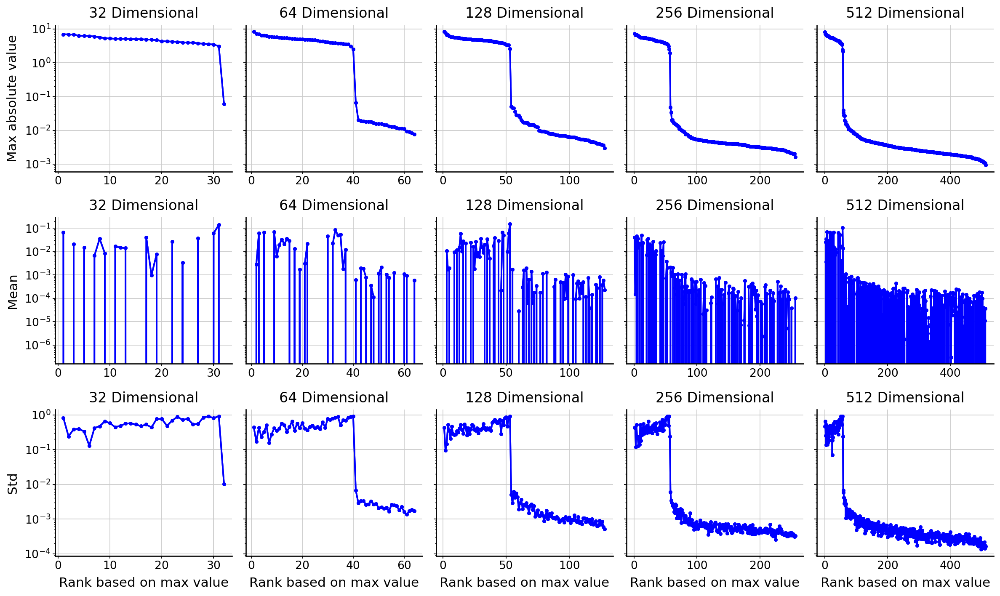

pancreas_scvelo


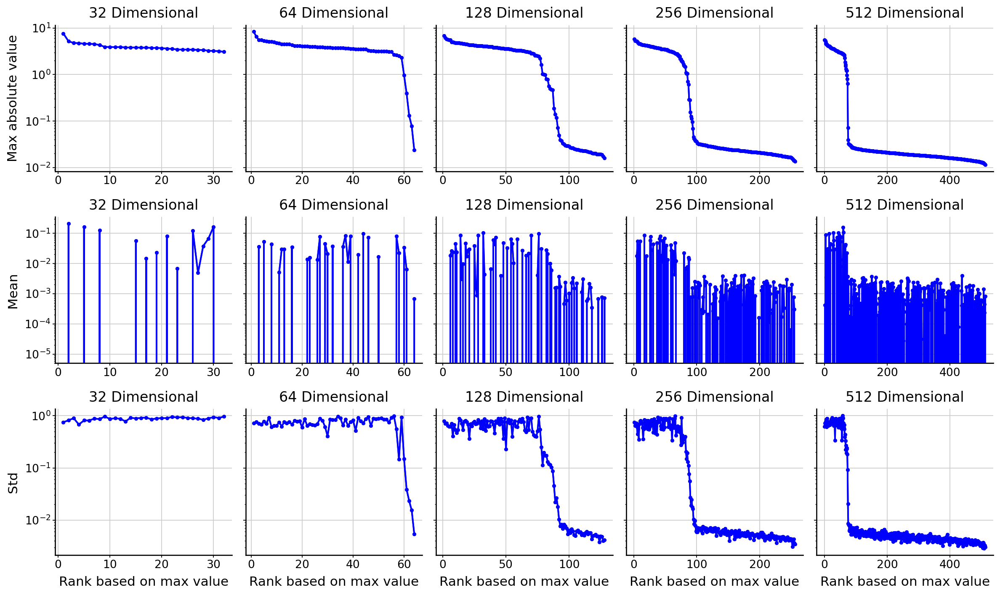

retina_organoid_hvg


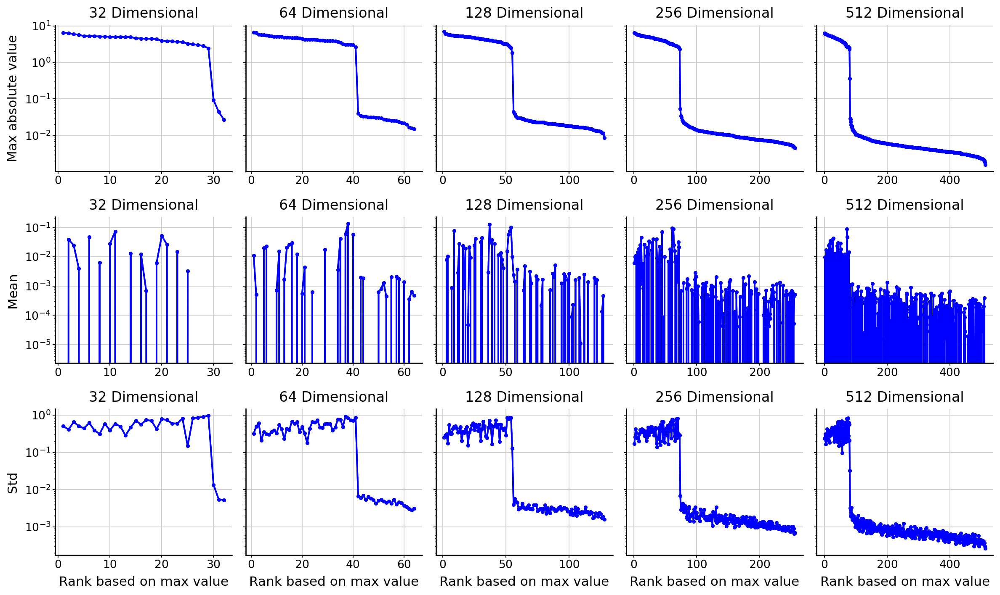

norman_hvg


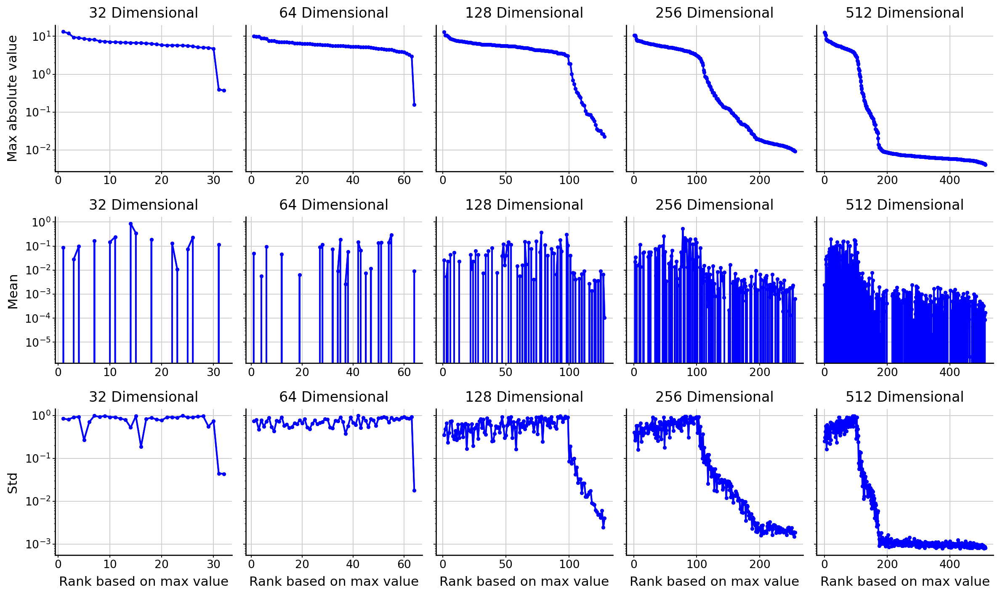

hlca


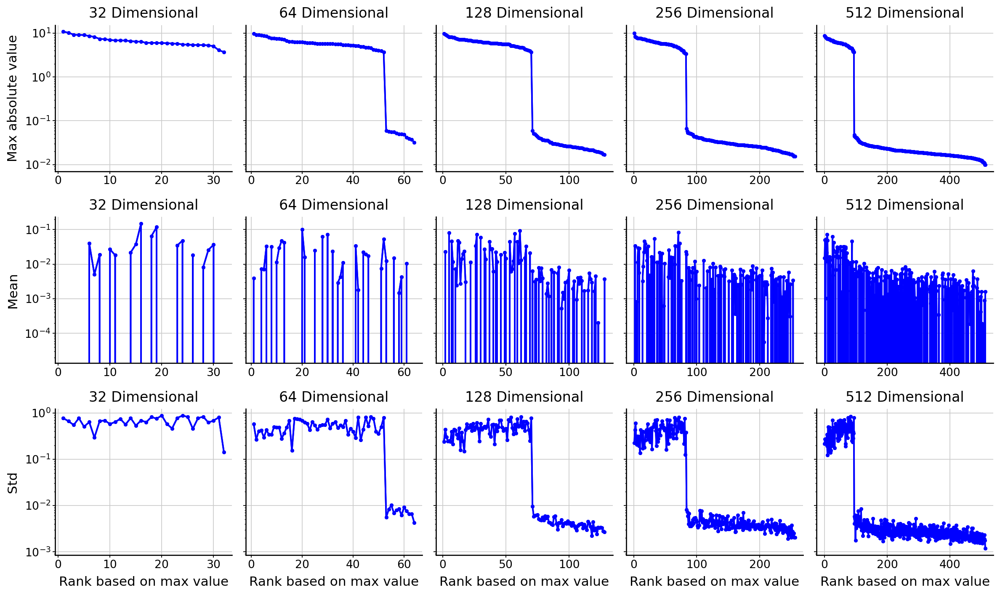

pbmc_covid_hvg


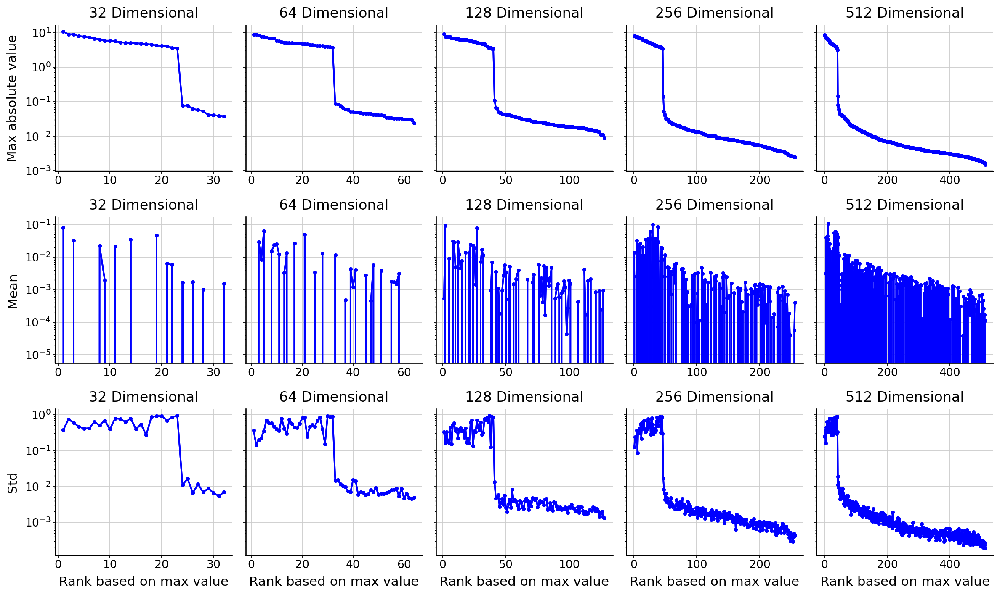

zebrafish_hvg


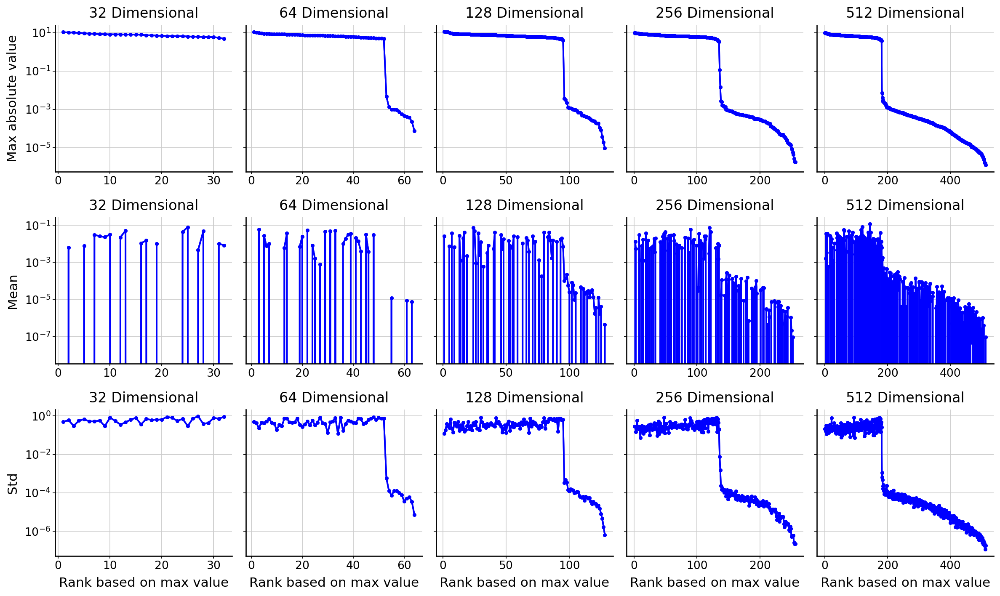

In [16]:
for run_name, embeds in all_embeds.items():
    print(run_name)
    
    fig, axes = plt.subplots(3, len(embeds), figsize=(15, 9), sharex=False, sharey='row')

    # Mapping metric names to y-axis titles
    metric_names = ["Max absolute value", "Mean", "Std"]
    log_titles = ["", " (log scale)"]
    
    for col, (method_name, embed) in enumerate(embeds.items()):
        order = np.argsort(np.abs(embed.X).max(axis=0))[::-1]
        max_value_array = np.abs(embed.X).max(axis=0)[order]
        mean_array = embed.X.mean(axis=0)[order]
        std_array = embed.X.std(axis=0)[order]
        ranks = np.arange(1, embed.n_vars + 1)
    
        # Mapping arrays to the y-axis titles
        metric_arrays = [max_value_array, mean_array, std_array]
    
        for row, (y_axis_title, x) in enumerate(zip(metric_names, metric_arrays)):
            for is_log in [True, False]:
                ax = axes[row, col]
                ax.plot(ranks, x, 'o', markersize=3, color='b')  # Plot points
                ax.plot(ranks, x, linestyle='-', color='b')  # Solid line plot
                
                if is_log:
                    ax.set_yscale('log')
                    ax.set_title(f"{method_name} {log_titles[1]}")
                else:
                    ax.set_title(f"{method_name}")
    
                if col == 0:
                    ax.set_ylabel(y_axis_title)
                
                if row == 2:
                    ax.set_xlabel('Rank based on max value')
                    
                ax.grid(axis='x')
                
                # Remove legends
                # ax.legend().remove()
    
    plt.tight_layout()
    plt.savefig(proj_dir / 'plots' / 'dim_effect' / f'combined_plot_{run_name}.pdf', bbox_inches='tight')
    plt.show()

In [17]:
LEGEND = False

In [18]:
import matplotlib.patches as mpatches

palette_label_mapping = {k: datasets[k]['name'].replace("\n", " ") for k in datasets}
def plot_the_metric(df, y_label, log_y=False, palette=None, palette_label_mapping=palette_label_mapping):
    if palette is None:
        palette = dict(zip(list(df.drop(columns=['n_latent']).iloc[-1].sort_values(ascending=False).index), cat_10_pallete))
    
    plt.figure(figsize=(5, 3))
    
    x = df['n_latent']
    
    for i, run_name in enumerate(df.columns):
        if run_name == 'n_latent':
            continue
        plt.plot(x, df[run_name], 'o', markersize=6, color=palette[run_name])  # Plot points
        plt.plot(x, df[run_name], linestyle='--', color=palette[run_name])  # Dotted line plot
        
    # Setting labels and title
    plt.xlabel('Number of latent dimensions')
    plt.ylabel(y_label)
    if log_y:
        plt.yscale('log', base=10) 
    
    plt.xticks(x, x, rotation=90)
                    
    # if zero_center:
    #     plt.ylim(ymin=0)
    
    # Adding vertical dotted lines for each n_latent value
    for val in x:
        plt.axvline(x=val, linestyle=':', color='grey', zorder=-10)

    if LEGEND:
        plt.legend(handles=[mpatches.Patch(color=c, label=palette_label_mapping[l]) for l, c in palette.items()],
                   loc='upper left', bbox_to_anchor=(1.1, 1.))

    plt.grid(False)
    return plt

In [19]:
palette = dict(zip(list(all_embeds.keys()), cat_10_pallete))

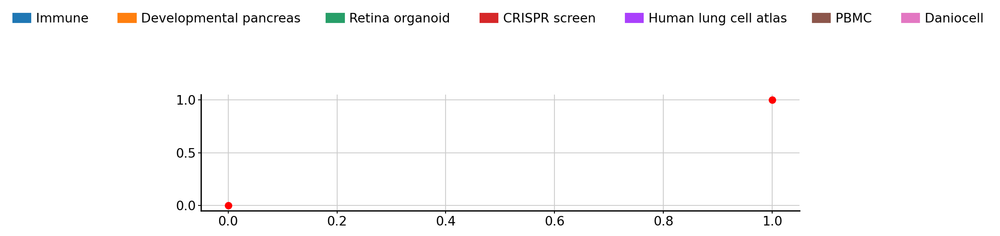

In [20]:
plt.figure(figsize=(10, 2))
plt.plot([0, 1], [0, 1], 'o', markersize=6, color='red')
plt.legend(handles=[mpatches.Patch(color=c, label=palette_label_mapping[l]) for l, c in palette.items()],
               loc='lower center', ncol=10, bbox_to_anchor=(0.5, 1.5))
plt.savefig(proj_dir / 'plots' / 'dim_effect' / 'legend_for_combined_plots.pdf', bbox_inches='tight')
plt.show()

In [21]:
embed_names_list = list(all_embeds[list(all_embeds.keys())[0]].keys())

In [22]:
plot_df = pd.DataFrame({
    'n_latent': [int(x.split(" ")[0]) for x in embed_names_list],
    **{
        f'{run_name}': [(np.abs(embeds[x].X).max(axis=0) > 0.1).sum() for x in list(embeds.keys())]
        for run_name, embeds in all_embeds.items()
    }}
)
plot_df

,n_latent,immune_hvg,pancreas_scvelo,retina_organoid_hvg,norman_hvg,hlca,pbmc_covid_hvg,zebrafish_hvg
0,32,31,32,29,32,32,23,32
1,64,40,62,41,64,52,32,52
2,128,53,90,55,113,70,41,95
3,256,57,92,73,154,83,47,136
4,512,58,74,81,142,94,43,181


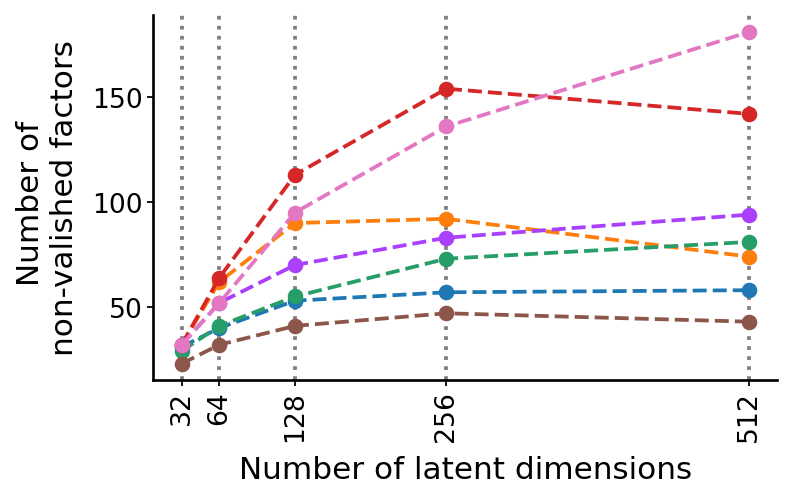

In [23]:
plt = plot_the_metric(plot_df, 'Number of \nnon-valished factors', palette=palette)
plt.savefig(proj_dir / 'plots' / 'dim_effect' / 'n_nonvanished_combined_plot.pdf', bbox_inches='tight')
plt.show()

# Disentanglement comparison

In [24]:
######################################
# Please run disentanglemnt notebook #
######################################

In [25]:
metric_abbr = {
    'Absolute Spearman Correlation': 'ASC',
    'Mutual Info Score': 'SMI',
    'NN Alignment': 'SPN',
}

disentanglement_results = {}
for metric_aggregation_type in ['LMS', 'MSAS', 'MSGS']:
    for metric_name in metric_abbr.values():
        disentanglement_results[f"{metric_aggregation_type}-{metric_name}"] = pd.DataFrame({
            'n_latent': [int(x.split(" ")[0]) for x in embed_names_list],
            **{
                f'{run_name}': np.zeros(len(embed_names_list))
                for run_name, embeds in all_embeds.items()
            }}
        ).set_index('n_latent')

for metric_aggregation_type in ['LMS', 'MSAS', 'MSGS']:
    for run_name in all_embeds.keys():
        try:
            results_df = pd.read_csv(proj_dir / 'results' / f'eval_disentanglement_{run_name}_ablation_{metric_aggregation_type}.csv')
        except:
            continue
        results_df['metric'] = results_df['metric'].map(metric_abbr)
        results_df = results_df.set_index('metric').T
        results_df.index = results_df.index.str.split(" ").str[0].astype(int)

        for metric_name in results_df.columns:
            disentanglement_results[f"{metric_aggregation_type}-{metric_name}"][run_name] = results_df[metric_name]

disentanglement_results[f"LMS-SMI"]

,immune_hvg,pancreas_scvelo,retina_organoid_hvg,norman_hvg,hlca,pbmc_covid_hvg,zebrafish_hvg
n_latent,,,,,,,
32,0.699132,0.557831,0.750818,0.037529,0.356940,0.329990,0.152309
64,0.725238,0.590377,0.741295,0.075242,0.557033,0.445394,0.257931
128,0.708577,0.619265,0.755442,0.108335,0.658289,0.520748,0.396387
256,0.714494,0.600938,0.756663,0.143392,0.704933,0.528740,0.512362
512,0.720123,0.637544,0.796975,0.147284,0.728412,0.543013,0.558818


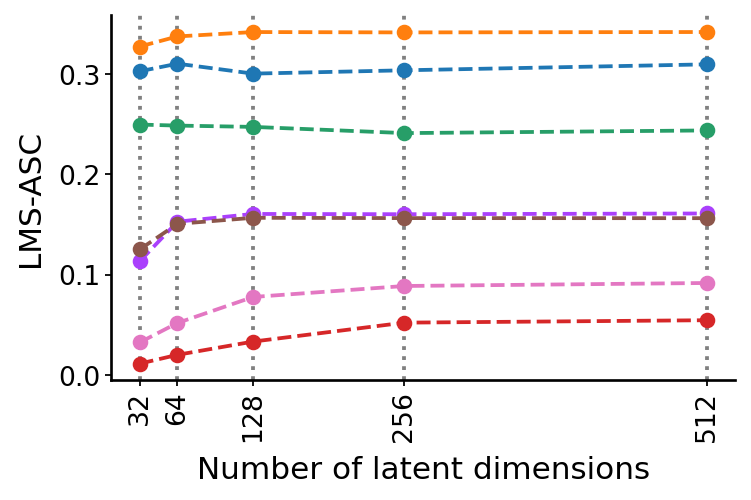

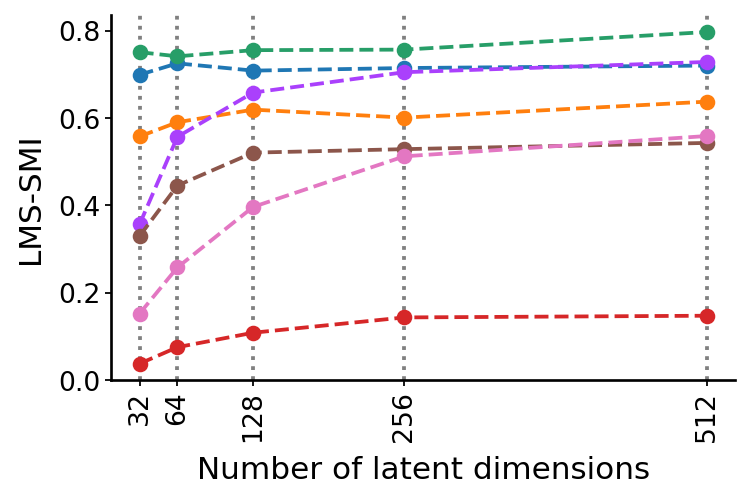

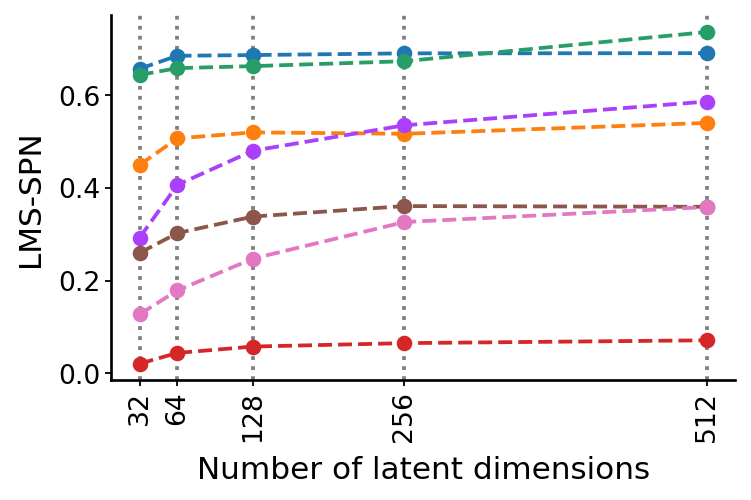

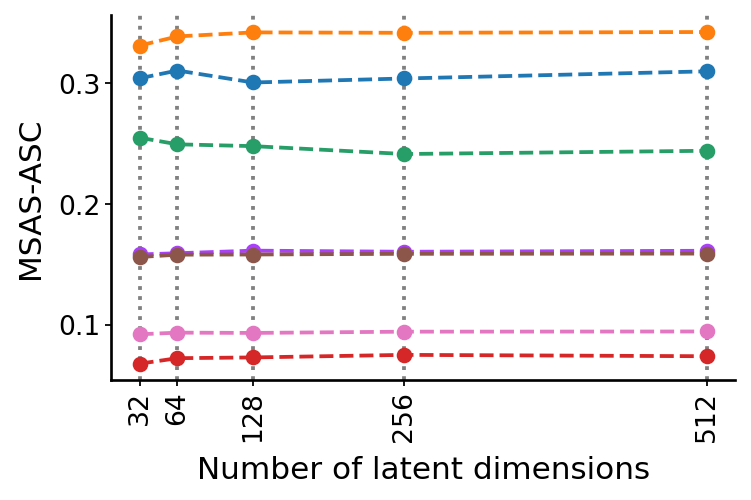

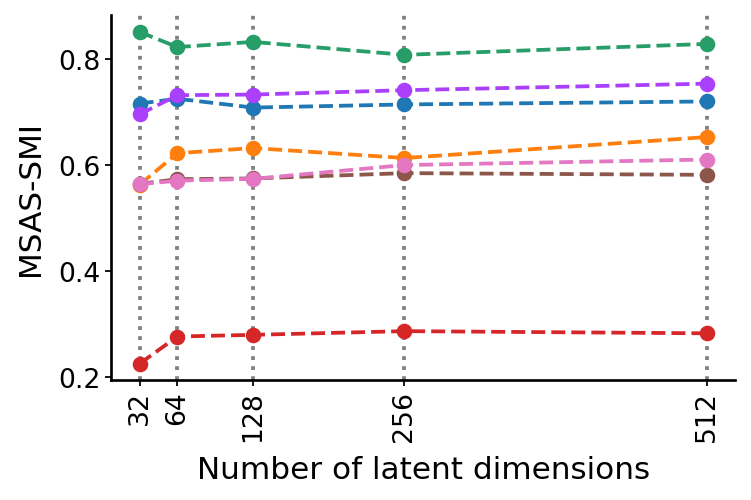

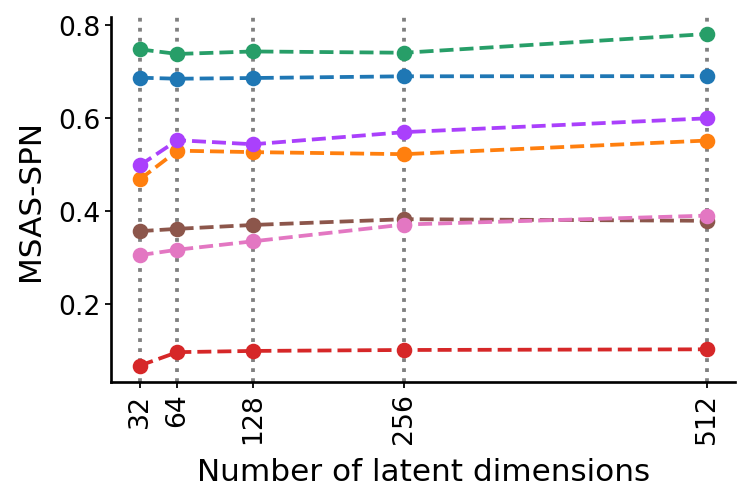

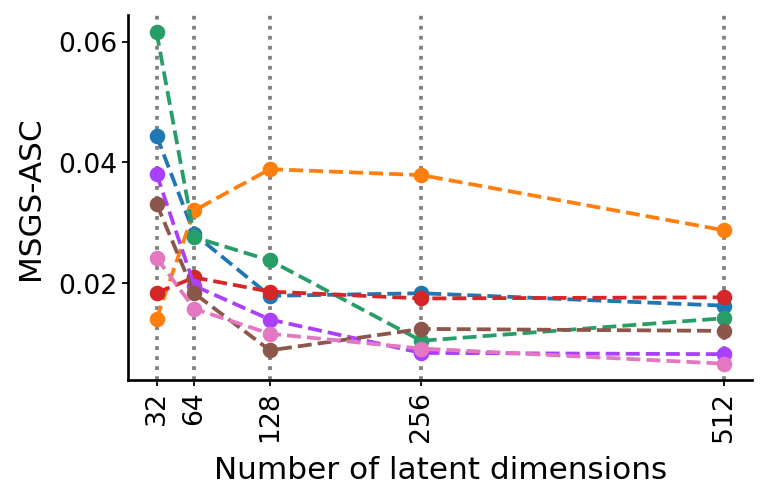

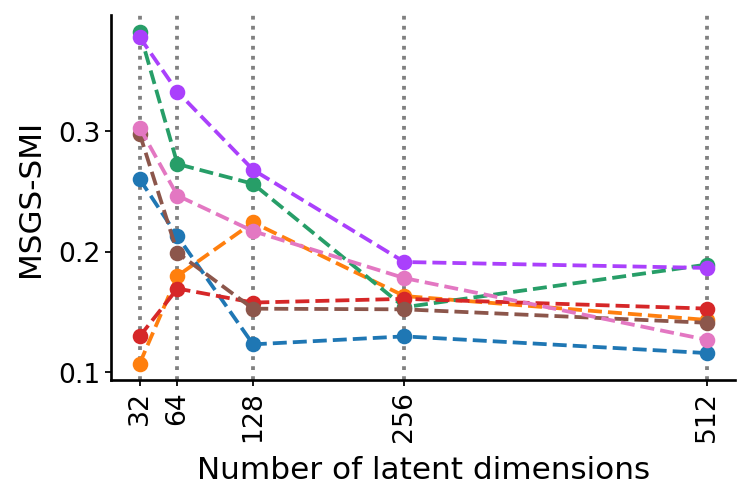

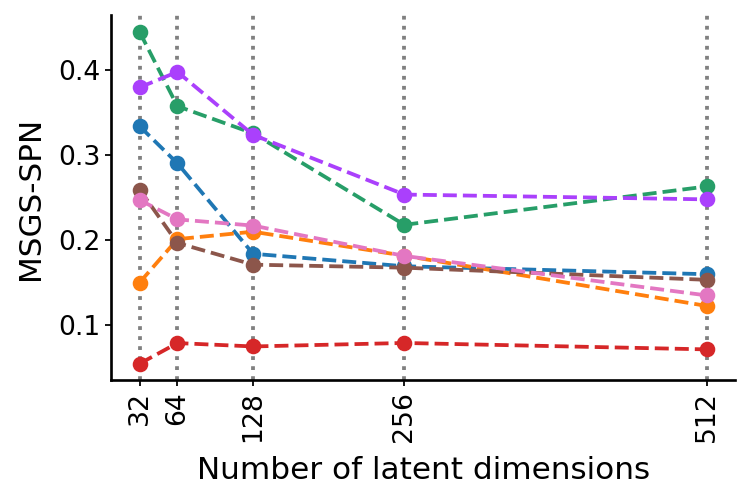

In [26]:
for metric_comb in disentanglement_results.keys():
    plot_df = disentanglement_results[metric_comb].copy()
    plt = plot_the_metric(plot_df.reset_index(), f"{metric_comb}", palette=palette)
    # plot_df = plot_df / (plot_df.iloc[0] + 1e-10)
    # plt = plot_the_metric(plot_df.reset_index(), f"{metric_comb} gain over\n32 dimensions")
    plt.savefig(proj_dir / 'plots' / 'dim_effect' / f'disentanglement_{metric_comb}_combined_plot.pdf', bbox_inches='tight')
    plt.show()

# Integration quality comparison

In [27]:
integration_results = {}
for metric_name in ['Bio conservation', 'Batch correction', 'Total']:
    integration_results[f"{metric_name}"] = pd.DataFrame({
        'n_latent': [int(x.split(" ")[0]) for x in embed_names_list],
        **{
            f'{run_name}': np.zeros(len(embed_names_list))
            for run_name, embeds in all_embeds.items()
            if all_info[run_name]['condition_key'] is not None
        }}
    ).set_index('n_latent')

for run_name in all_embeds.keys():
    if all_info[run_name]['condition_key'] is None:
        continue
    try:
        scib_df = pd.read_csv(proj_dir / 'results' / f'scib_results_{run_name}_ablation.csv', index_col=0).reset_index(names='method')
    except:
        continue
    scib_df = scib_df[['method', 'Bio conservation', 'Batch correction', 'Total']]
    scib_df = scib_df.set_index('method')
    scib_df.index = scib_df.index.str.split(" ").str[0].astype(int)

    for metric_name in scib_df.columns:
        integration_results[f"{metric_name}"][run_name] = scib_df[metric_name]

integration_results[f"Total"]

,immune_hvg,retina_organoid_hvg,hlca,pbmc_covid_hvg
n_latent,,,,
32,0.654214,0.659658,0.641098,0.554008
64,0.655721,0.644785,0.633696,0.550584
128,0.645930,0.642541,0.643579,0.588142
256,0.663895,0.651734,0.638932,0.561879
512,0.658504,0.642185,0.641404,0.561332


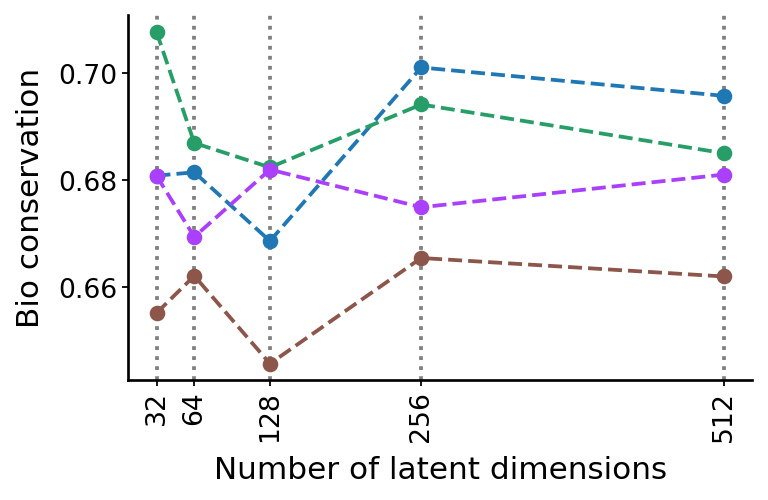

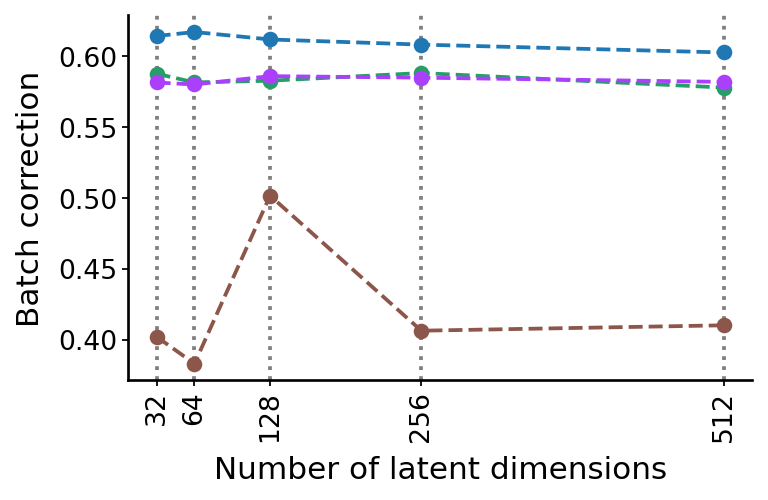

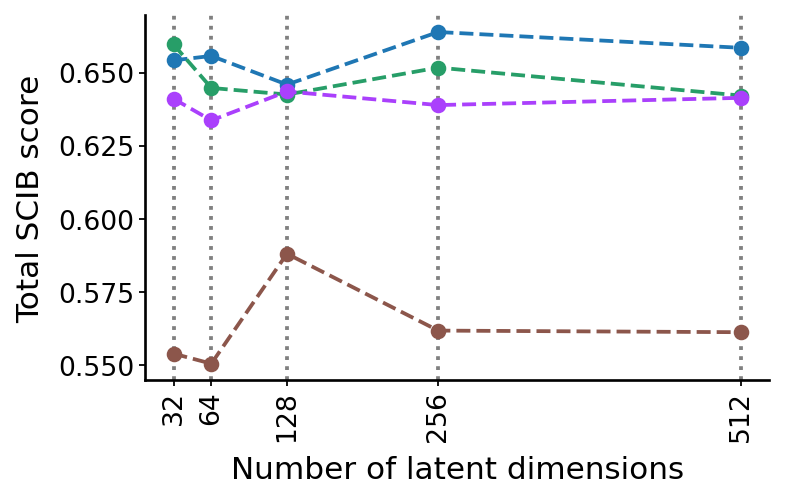

In [28]:
for metric in integration_results.keys():
    plot_df = integration_results[metric].copy()
    title = metric
    if title == 'Total':
        title = 'Total SCIB score'
    plt = plot_the_metric(plot_df.reset_index(), title, palette=palette)
    plt.savefig(proj_dir / 'plots' / 'dim_effect' / f'integration_{metric}_combined_plot.pdf', bbox_inches='tight')
    plt.show()